# Analysis

In these notes, the billboard feature data is looked more closely into. 

If you haven't downloaded the data, check `notes/data.ipynb` notebook!

In [1]:
# First set up the environment. Code sources are in folders which are in the parent folder of this notebooks scope.
import sys; sys.path.insert(0, '..') # add parent folder path, now files are queriable from parent folder

In [2]:
from data.query.util import loadJson

notHitSongPath = '../data/datasets/spotify/not_hit_song.json'
hitSongPath = '../data/datasets/spotify/hit_song.json'

# Load the data
hits = loadJson(hitSongPath)
notHits = loadJson(notHitSongPath)

The main idea of this analysis is to check if there are some distinguishable groups for the features. The principal component analysis PCA is used to transform the data into a more visualizable form.

But first let's check how the data looks among release years.

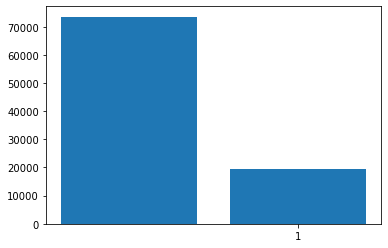

In [5]:
from data.plotting.util import makeHistogram

# Here is the number of hits and not hits
makeHistogram([0, 1], [len(notHits), len(hits)])

In [3]:
from data.types.process import ModelFeatures
from data.types.spotify import SpotifyFeatures

def preprocessFeatures(features: SpotifyFeatures) -> ModelFeatures:
    return np.array([[float(f) for f in list(features.values())]], dtype='float32')
    

In [4]:
import numpy as np

# First take all features and store dates for later use
# features[i] will have a date dates[i]
for i, hit in enumerate(hits):
    features = preprocessFeatures(hit['features'])
    if i == 0:
        data = features
        continue
    data = np.append(data, features, axis=0)

print(data.shape)

(19462, 13)


In [8]:
np.set_printoptions(suppress=True)
print(data[0:5])

[[     4.        164442.             8.             1.
       0.00323        0.759          0.459          0.
       0.0906        -5.187          0.0948         0.695
     109.997    ]
 [     4.        178147.             9.             1.
       0.335          0.563          0.664          0.
       0.0849        -5.044          0.154          0.688
     166.928    ]
 [     4.        203808.             6.             0.
       0.0561         0.695          0.884          0.
       0.213         -2.278          0.0753         0.914
     103.014    ]
 [     4.        137704.             8.             0.
       0.293          0.593          0.503          0.
       0.405         -6.725          0.22           0.71
     178.781    ]
 [     4.        231041.            11.             0.
       0.0469         0.808          0.897          0.0000314
       0.364         -3.712          0.0348         0.591
     126.026    ]]


In [9]:
from sklearn.preprocessing import MinMaxScaler

# Now with scikit learn scaler let's scale everything between 0 and 1
scaler = MinMaxScaler()
scaler.fit(data)
scaledData = scaler.transform(data)

print(scaledData[0:5])

[[0.8        0.08911281 0.72727275 1.         0.00324391 0.76821864
  0.44864973 0.         0.08221836 0.7649167  0.10160772 0.70131177
  0.4712225 ]
 [0.8        0.0986969  0.8181819  1.         0.33668187 0.5698381
  0.65834695 0.         0.07642762 0.76941216 0.16505894 0.69424826
  0.71511245]
 [0.8        0.11664198 0.54545456 0.         0.05637971 0.7034413
  0.88338786 0.         0.2065669  0.8563659  0.08070739 0.9223007
  0.4413076 ]
 [0.8        0.07041457 0.72727275 0.         0.29447073 0.60020244
  0.49365792 0.         0.40162343 0.71656716 0.2357985  0.716448
  0.76589024]
 [0.8        0.13568638 1.         0.         0.04713345 0.8178138
  0.8966858  0.00003175 0.35997072 0.8112858  0.03729903 0.5963673
  0.53989005]]


In [10]:
# Max and minimium values for every column
np.set_printoptions(suppress=True)
print(scaler.data_max_)
print("\n", scaler.data_min_)

[      5.    1466987.         11.          1.          0.995       0.988
       0.998       0.989       0.994       2.291       0.933       0.991
     233.429]

 [    0.         37013.             0.             0.
     0.00000232     0.             0.0204         0.
     0.00967      -29.519          0.             0.
     0.        ]


In [11]:
from sklearn.decomposition import PCA

# Two-dimensional data
pca2 = PCA(n_components=2)
pca2.fit(scaledData)
pcaTwoData = pca2.transform(scaledData)

# Two-dimensional data
pca3 = PCA(n_components=3)
pca3.fit(scaledData)
pcaThreeData = pca3.transform(scaledData)

print(pcaTwoData[:10])
print("\n", pcaThreeData[:10])

[[-0.14922166 -0.14599235]
 [-0.18176912  0.04384707]
 [ 0.8047862  -0.30944628]
 [ 0.74585575  0.18320648]
 [ 0.894394   -0.08522811]
 [-0.23810557 -0.15743071]
 [-0.3458506  -0.19349691]
 [-0.2784575  -0.5184229 ]
 [-0.39224175  0.20877056]
 [ 0.71401    -0.06358187]]

 [[-0.1492217  -0.14599088 -0.35966063]
 [-0.18176913  0.04384885 -0.4020789 ]
 [ 0.8047862  -0.3094464  -0.02301406]
 [ 0.7458558   0.1832065  -0.04554684]
 [ 0.8943939  -0.0852267  -0.40636313]
 [-0.23810562 -0.15743029 -0.09160646]
 [-0.34585062 -0.19349839  0.3682406 ]
 [-0.27845758 -0.5184241   0.26098913]
 [-0.39224172  0.20876923  0.315005  ]
 [ 0.71401006 -0.06358324  0.25963977]]


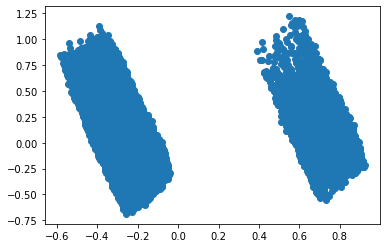

In [14]:
import matplotlib.pyplot as plt

# Some plotting of the data
x, y = zip(*pcaTwoData)
plt.scatter(x, y)
plt.show()

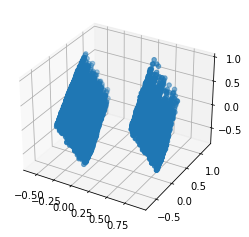

In [16]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

x, y, z = zip(*pcaThreeData)
ax.scatter(x, y, z)
plt.show()

In [17]:
from sklearn.decomposition import PCA

# Two-dimensional data
pca2 = PCA(n_components=2)
pca2.fit(data)
pcaTwoData = pca2.transform(data)

# Two-dimensional data
pca3 = PCA(n_components=3)
pca3.fit(data)
pcaThreeData = pca3.transform(data)

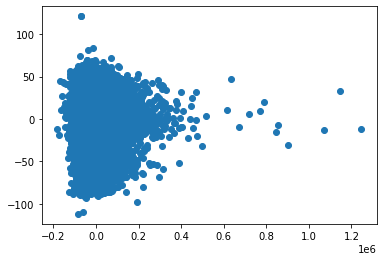

In [18]:
# Some plotting of the data
x, y = zip(*pcaTwoData)
plt.scatter(x, y)
plt.show()

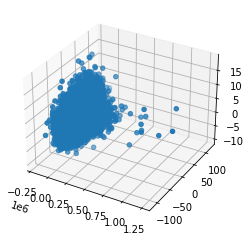

In [19]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

x, y, z = zip(*pcaThreeData)
ax.scatter(x, y, z)
plt.show()

In [38]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler

# Now with scikit learn scaler let's scale everything between 0 and 1
scaler = ColumnTransformer([ ("scale", MinMaxScaler(), [0, 1, 2, 9, 12]) ], remainder='passthrough')
scaler.fit(data)
scaledData2 = scaler.transform(data)
print(data[0:5], "\n")
print(scaledData2[0:5])

[[     4.        164442.             8.             1.
       0.00323        0.759          0.459          0.
       0.0906        -5.187          0.0948         0.695
     109.997    ]
 [     4.        178147.             9.             1.
       0.335          0.563          0.664          0.
       0.0849        -5.044          0.154          0.688
     166.928    ]
 [     4.        203808.             6.             0.
       0.0561         0.695          0.884          0.
       0.213         -2.278          0.0753         0.914
     103.014    ]
 [     4.        137704.             8.             0.
       0.293          0.593          0.503          0.
       0.405         -6.725          0.22           0.71
     178.781    ]
 [     4.        231041.            11.             0.
       0.0469         0.808          0.897          0.0000314
       0.364         -3.712          0.0348         0.591
     126.026    ]] 

[[0.8        0.08911281 0.72727275 0.7649167  0.4712225  1.
 

In [39]:
from scipy.stats import describe
np.set_printoptions(suppress=True)

describe(scaledData2)

DescribeResult(nobs=19462, minmax=(array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.00000232, 0.        , 0.0204    , 0.        ,
       0.00967   , 0.        , 0.        ], dtype=float32), array([1.        , 1.        , 1.        , 1.        , 0.99999994,
       1.        , 0.995     , 0.988     , 0.998     , 0.989     ,
       0.994     , 0.933     , 0.991     ], dtype=float32)), mean=array([0.7871957 , 0.12858513, 0.47325328, 0.654017  , 0.51751626,
       0.73193914, 0.29247352, 0.60043824, 0.62184834, 0.03401749,
       0.19232233, 0.07270832, 0.6081333 ], dtype=float32), variance=array([0.00392627, 0.00222939, 0.10468185, 0.01267625, 0.01464453,
       0.19621433, 0.07847555, 0.02302769, 0.03921494, 0.01944753,
       0.02580937, 0.00690519, 0.05720776], dtype=float32), skewness=array([-4.669079  ,  2.5176861 ,  0.01094254, -0.58281773,  0.5036696 ,
       -1.047059  ,  0.7577276 , -0.24832551, -0.32077432,  4.9089723 ,
        2.1128156 ,  

In [40]:
from sklearn.decomposition import PCA

# Two-dimensional data
pca2 = PCA(n_components=2)
pca2.fit(scaledData2)
pcaTwoData = pca2.transform(scaledData2)

# Two-dimensional data
pca3 = PCA(n_components=3)
pca3.fit(scaledData2)
pcaThreeData = pca3.transform(scaledData2)

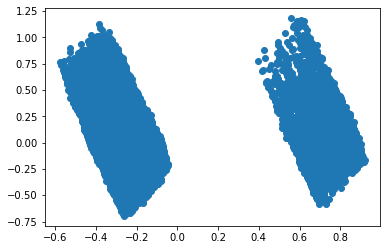

In [41]:
# Some plotting of the data
x, y = zip(*pcaTwoData)
plt.scatter(x, y)
plt.show()

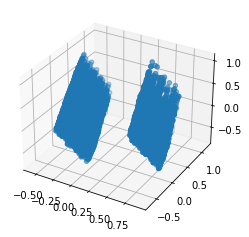

In [42]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

x, y, z = zip(*pcaThreeData)
ax.scatter(x, y, z)
plt.show()

In [5]:
from pandas import DataFrame

def parseYearFromDate(date: str) -> int:
    if '-' in date:
        split = date.split('-')
        if len(split) == 3:
            year, month, day = split
        elif len(split) == 2:
            year, month = split
        return year
            
    elif len(date) == 4:
        return date
    
    return ""

features = []
years = []
decades = []
for hit in hits:
    year = parseYearFromDate(hit['info']['spotifyData']['album']['releaseDate'])
    features.append({**hit['features'], 'decade': year[2]+"0"})
    years.append(year)
    decades.append(year[2]+"0")

years = tuple(years)
decades = tuple(decades)

df = DataFrame.from_records(features)

df

,timeSignature,durationMS,key,mode,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,tempo,decade
0,4,164442,8,1,0.00323,0.759,0.459,0.000000,0.0906,-5.187,0.0948,0.695,109.997,20
1,4,178147,9,1,0.33500,0.563,0.664,0.000000,0.0849,-5.044,0.1540,0.688,166.928,20
2,4,203808,6,0,0.05610,0.695,0.884,0.000000,0.2130,-2.278,0.0753,0.914,103.014,20
3,4,137704,8,0,0.29300,0.593,0.503,0.000000,0.4050,-6.725,0.2200,0.710,178.781,20
4,4,231041,11,0,0.04690,0.808,0.897,0.000031,0.3640,-3.712,0.0348,0.591,126.026,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19457,4,141107,0,1,0.85800,0.543,0.560,0.000000,0.3090,-8.703,0.1170,0.653,157.198,20
19458,4,159293,5,1,0.74300,0.560,0.270,0.000346,0.1720,-15.080,0.0412,0.305,78.674,60
19459,4,510960,0,1,0.93100,0.203,0.156,0.788000,0.0910,-20.173,0.0343,0.192,73.157,90
19460,4,152200,8,1,0.43200,0.744,0.508,0.000320,0.0808,-12.023,0.1150,0.686,116.528,80


In [6]:
decades = [int(decade) for decade in decades]

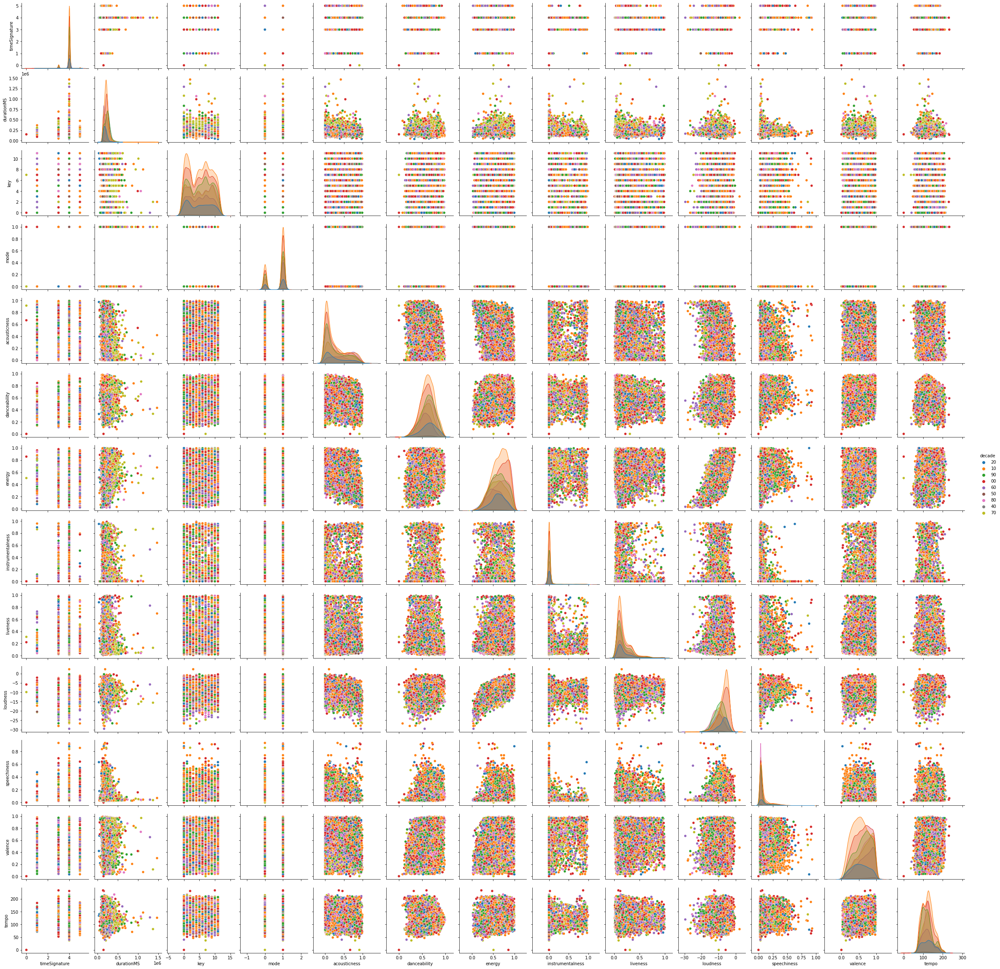

In [119]:
import seaborn as sns
%matplotlib inline

sns.pairplot(df, hue='decade')

Without class features

In [117]:
withoutTMK = df.drop(['timeSignature', 'mode', 'key'],axis=1)

In [118]:
withoutTMK

,durationMS,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,tempo,decade
0,164442,0.00323,0.759,0.459,0.000000,0.0906,-5.187,0.0948,0.695,109.997,20
1,178147,0.33500,0.563,0.664,0.000000,0.0849,-5.044,0.1540,0.688,166.928,20
2,203808,0.05610,0.695,0.884,0.000000,0.2130,-2.278,0.0753,0.914,103.014,20
3,137704,0.29300,0.593,0.503,0.000000,0.4050,-6.725,0.2200,0.710,178.781,20
4,231041,0.04690,0.808,0.897,0.000031,0.3640,-3.712,0.0348,0.591,126.026,20
...,...,...,...,...,...,...,...,...,...,...,...
19457,141107,0.85800,0.543,0.560,0.000000,0.3090,-8.703,0.1170,0.653,157.198,20
19458,159293,0.74300,0.560,0.270,0.000346,0.1720,-15.080,0.0412,0.305,78.674,60
19459,510960,0.93100,0.203,0.156,0.788000,0.0910,-20.173,0.0343,0.192,73.157,90
19460,152200,0.43200,0.744,0.508,0.000320,0.0808,-12.023,0.1150,0.686,116.528,80


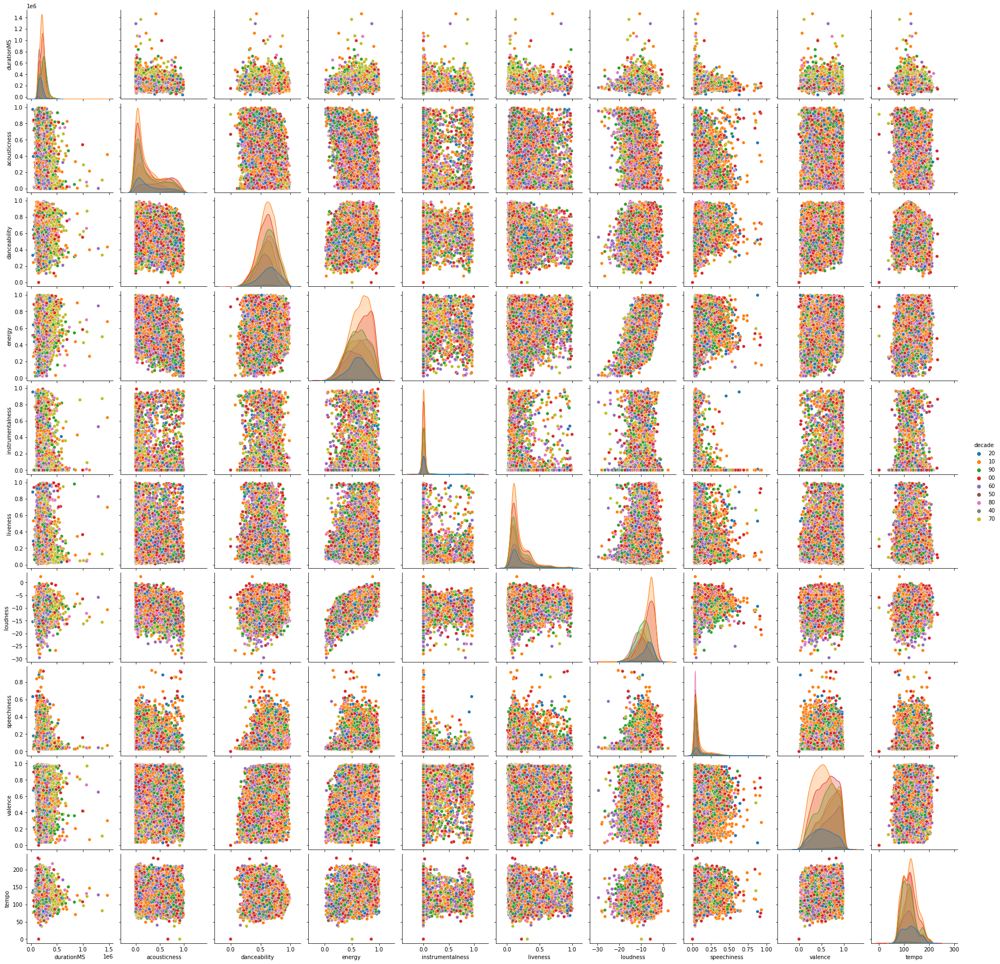

In [120]:
%matplotlib inline
sns.pairplot(withoutTMK, hue='decade')

In [122]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler

# Now with scikit learn scaler let's scale everything between 0 and 1
scaler = ColumnTransformer([ ("scale", MinMaxScaler(), ['durationMS', 'loudness', 'tempo']) ], remainder='passthrough')
scaler.fit(withoutTMK.drop(['decade'],axis=1))
scaled = scaler.transform(withoutTMK.drop(['decade'],axis=1))

print(scaled[0:5])

[[0.08911281 0.76491669 0.47122251 0.00323    0.759      0.459
  0.         0.0906     0.0948     0.695     ]
 [0.0986969  0.76941213 0.71511252 0.335      0.563      0.664
  0.         0.0849     0.154      0.688     ]
 [0.11664198 0.85636592 0.44130764 0.0561     0.695      0.884
  0.         0.213      0.0753     0.914     ]
 [0.07041457 0.71656712 0.76589027 0.293      0.593      0.503
  0.         0.405      0.22       0.71      ]
 [0.13568638 0.81128576 0.53989007 0.0469     0.808      0.897
  0.0000314  0.364      0.0348     0.591     ]]


In [123]:
from sklearn.decomposition import PCA

# Two-dimensional data
pca2 = PCA(n_components=2)
pca2.fit(scaled)
pcaTwoData = pca2.transform(scaled)

# Two-dimensional data
pca3 = PCA(n_components=3)
pca3.fit(scaled)
pcaThreeData = pca3.transform(scaled)

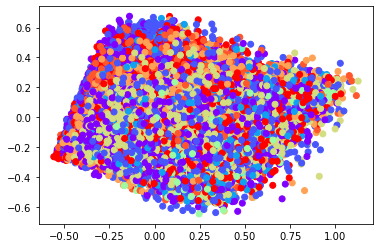

In [129]:
%matplotlib inline
# Some plotting of the data
x, y = zip(*pcaTwoData)
plt.scatter(x, y, c=decades, cmap='rainbow')
plt.show()

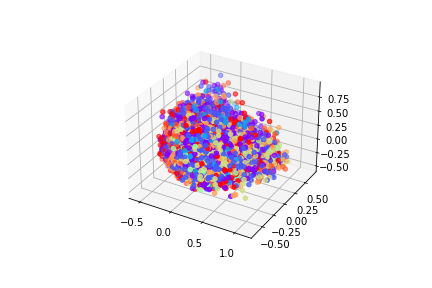

In [130]:
%matplotlib widget
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

x, y, z = zip(*pcaThreeData)
ax.scatter(x, y, z, c=decades, cmap='rainbow')
plt.show()

Scaled & one hot encoded

In [131]:
df

,timeSignature,durationMS,key,mode,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,tempo,decade
0,4,164442,8,1,0.00323,0.759,0.459,0.000000,0.0906,-5.187,0.0948,0.695,109.997,20
1,4,178147,9,1,0.33500,0.563,0.664,0.000000,0.0849,-5.044,0.1540,0.688,166.928,20
2,4,203808,6,0,0.05610,0.695,0.884,0.000000,0.2130,-2.278,0.0753,0.914,103.014,20
3,4,137704,8,0,0.29300,0.593,0.503,0.000000,0.4050,-6.725,0.2200,0.710,178.781,20
4,4,231041,11,0,0.04690,0.808,0.897,0.000031,0.3640,-3.712,0.0348,0.591,126.026,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19457,4,141107,0,1,0.85800,0.543,0.560,0.000000,0.3090,-8.703,0.1170,0.653,157.198,20
19458,4,159293,5,1,0.74300,0.560,0.270,0.000346,0.1720,-15.080,0.0412,0.305,78.674,60
19459,4,510960,0,1,0.93100,0.203,0.156,0.788000,0.0910,-20.173,0.0343,0.192,73.157,90
19460,4,152200,8,1,0.43200,0.744,0.508,0.000320,0.0808,-12.023,0.1150,0.686,116.528,80


In [132]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder

# Now with scikit learn scaler let's scale everything between 0 and 1
scaler = ColumnTransformer([ 
    ("scale", MinMaxScaler(), ['durationMS', 'loudness', 'tempo']),
    ("normalize", OneHotEncoder(), ['timeSignature', 'key', 'mode'])
    ], remainder='passthrough')
scaler.fit(df.drop(['decade'],axis=1))
scaled = scaler.transform(df.drop(['decade'],axis=1))

In [133]:
from sklearn.decomposition import TruncatedSVD

# Two-dimensional data
pca2 = TruncatedSVD(n_components=2)
pca2.fit(scaled)
pcaTwoData = pca2.transform(scaled)

# Two-dimensional data
pca3 = TruncatedSVD(n_components=3)
pca3.fit(scaled)
pcaThreeData = pca3.transform(scaled)

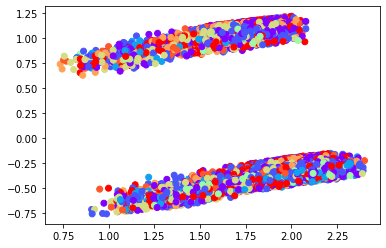

In [135]:
%matplotlib inline
# Some plotting of the data
x, y = zip(*pcaTwoData)
plt.scatter(x, y, c=decades, cmap='rainbow')
plt.show()

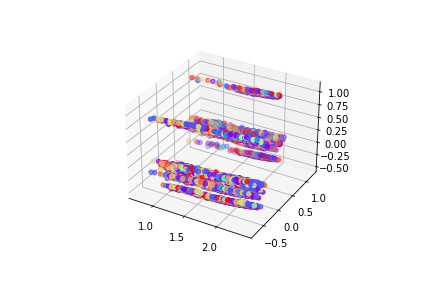

In [136]:
%matplotlib widget
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

x, y, z = zip(*pcaThreeData)
ax.scatter(x, y, z, c=decades, cmap='rainbow')
plt.show()

In [137]:
scaled[0]

array([0.08911281, 0.76491669, 0.47122251, 0.        , 0.        ,
       0.        , 1.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 1.        , 0.        , 0.        , 0.        ,
       0.        , 1.        , 0.00323   , 0.759     , 0.459     ,
       0.        , 0.0906    , 0.0948    , 0.695     ])

Scaled, one hot encoded & decades included

In [138]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder

# Now with scikit learn scaler let's scale everything between 0 and 1
scaler = ColumnTransformer([ 
    ("scale", MinMaxScaler(), ['durationMS', 'loudness', 'tempo', 'decade']),
    ("normalize", OneHotEncoder(), ['timeSignature', 'key', 'mode'])
    ], remainder='passthrough')
scaler.fit(df)
scaled = scaler.transform(df)

In [139]:
from sklearn.decomposition import TruncatedSVD

# Two-dimensional data
pca2 = TruncatedSVD(n_components=2)
pca2.fit(scaled)
pcaTwoData = pca2.transform(scaled)

# Two-dimensional data
pca3 = TruncatedSVD(n_components=3)
pca3.fit(scaled)
pcaThreeData = pca3.transform(scaled)

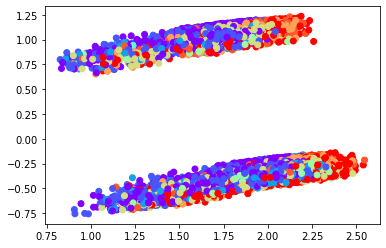

In [140]:
%matplotlib inline
# Some plotting of the data
x, y = zip(*pcaTwoData)
plt.scatter(x, y, c=decades, cmap='rainbow')
plt.show()

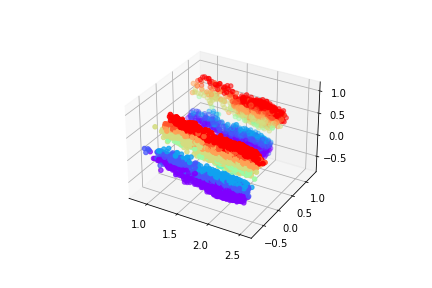

In [141]:
%matplotlib widget
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

x, y, z = zip(*pcaThreeData)
ax.scatter(x, y, z, c=decades, cmap='rainbow')
plt.show()

In [8]:
hitsDf = df

In [9]:
from pandas import DataFrame
from data.process.util import parseYearFromDate

NHfeatures = []
NHyears = []
NHdecades = []
for notHit in notHits:
    year = parseYearFromDate(notHit['info']['spotifyData']['album']['releaseDate'])
    NHfeatures.append({**notHit['features'], 'decade': year[2]+"0"})
    NHyears.append(year)
    NHdecades.append(year[2]+"0")

years = tuple(years)
decades = tuple(decades)

notHitsDf = DataFrame.from_records(NHfeatures)

notHitsDf

,timeSignature,durationMS,key,mode,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,tempo,decade
0,4,258004,11,0,0.00173,0.659,0.667,0.000029,0.1000,-4.668,0.0339,0.468,115.982,20
1,4,203064,6,0,0.00883,0.702,0.825,0.000000,0.0674,-3.787,0.0601,0.915,102.977,20
2,4,195352,5,1,0.01850,0.809,0.623,0.000088,0.0538,-6.254,0.1450,0.570,114.986,20
3,4,221820,4,0,0.16700,0.730,0.729,0.000001,0.3490,-3.434,0.0884,0.467,113.011,20
4,4,200108,11,0,0.00450,0.640,0.665,0.000000,0.2200,-4.966,0.0325,0.420,113.213,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73557,3,167867,5,1,0.82700,0.465,0.342,0.000000,0.2520,-9.549,0.0301,0.516,108.041,50
73558,4,169240,5,1,0.44700,0.664,0.660,0.000000,0.2980,-6.526,0.1300,0.873,84.345,50
73559,4,138160,5,1,0.61700,0.576,0.725,0.000027,0.2370,-5.329,0.0909,0.803,183.350,50
73560,4,107467,3,1,0.72800,0.574,0.560,0.000000,0.2460,-8.466,0.0502,0.896,160.928,50


In [10]:
hitsDf['decade'].unique()

array(['20', '10', '90', '00', '60', '50', '80', '40', '70'], dtype=object)

In [11]:
notHitsDf['decade'].unique()

array(['20', '10', '90', '00', '60', '50', '80', '40', '70'], dtype=object)

In [16]:
# Get a sample with same size as hits by decade from not hits
for decade in hitsDf['decade'].unique():
    num = hitsDf[hitsDf['decade'] == decade].shape[0]
    print(decade, num)

20 1107
10 4602
90 3080
00 3892
60 1707
50 106
80 2500
40 5
70 2463


In [64]:
from pandas import DataFrame, concat

# Decades over sixties will be used as the number of songs in the earlier is so small
# every decade will be sampled with 1707
for i, decade in enumerate(hitsDf['decade'].unique()):
    if decade in ['40', '50']:
        continue
    allHitsInDecade = hitsDf[hitsDf['decade'] == decade]
    if i == 0:
        hitSamples = allHitsInDecade.sample(1107)
        continue
    hitSamples = concat([hitSamples, allHitsInDecade.sample(1107)])

hitSamples

,timeSignature,durationMS,key,mode,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,tempo,decade
12576,4,178776,3,0,0.14600,0.752,0.563,0.000000,0.1030,-8.066,0.2090,0.551,145.050,20
608,4,192705,8,0,0.32500,0.776,0.752,0.000000,0.3300,-4.711,0.1930,0.716,140.013,20
633,4,156077,9,1,0.21700,0.485,0.814,0.000000,0.1120,-3.907,0.1380,0.327,159.894,20
571,4,194819,9,1,0.85600,0.263,0.393,0.000000,0.0975,-7.783,0.0291,0.205,86.806,20
18224,3,159027,5,0,0.91300,0.236,0.452,0.000019,0.8280,-9.353,0.0341,0.568,179.939,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8815,4,209800,10,1,0.00589,0.671,0.671,0.006760,0.2770,-11.894,0.0558,0.707,131.329,70
9879,4,233507,9,1,0.12400,0.626,0.565,0.000000,0.0811,-10.027,0.0271,0.924,116.610,70
16889,4,188208,0,0,0.54000,0.355,0.493,0.000321,0.1440,-11.849,0.0319,0.572,81.650,70
16103,4,521427,9,0,0.06860,0.697,0.923,0.809000,0.0251,-3.914,0.0921,0.870,121.508,70


In [65]:
from pandas import Series

hitSamples['label'] = '1'
hitSamples

,timeSignature,durationMS,key,mode,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,tempo,decade,label
12576,4,178776,3,0,0.14600,0.752,0.563,0.000000,0.1030,-8.066,0.2090,0.551,145.050,20,1
608,4,192705,8,0,0.32500,0.776,0.752,0.000000,0.3300,-4.711,0.1930,0.716,140.013,20,1
633,4,156077,9,1,0.21700,0.485,0.814,0.000000,0.1120,-3.907,0.1380,0.327,159.894,20,1
571,4,194819,9,1,0.85600,0.263,0.393,0.000000,0.0975,-7.783,0.0291,0.205,86.806,20,1
18224,3,159027,5,0,0.91300,0.236,0.452,0.000019,0.8280,-9.353,0.0341,0.568,179.939,20,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8815,4,209800,10,1,0.00589,0.671,0.671,0.006760,0.2770,-11.894,0.0558,0.707,131.329,70,1
9879,4,233507,9,1,0.12400,0.626,0.565,0.000000,0.0811,-10.027,0.0271,0.924,116.610,70,1
16889,4,188208,0,0,0.54000,0.355,0.493,0.000321,0.1440,-11.849,0.0319,0.572,81.650,70,1
16103,4,521427,9,0,0.06860,0.697,0.923,0.809000,0.0251,-3.914,0.0921,0.870,121.508,70,1


In [67]:
from pandas import concat

# Decades over sixties will be used as the number of songs in the earlier is so small
# every decade will be sampled with 1707
for i, decade in enumerate(notHitsDf['decade'].unique()):
    if decade in ['40', '50']:
        continue
    allNotHitsInDecade = notHitsDf[notHitsDf['decade'] == decade]
    if i == 0:
        notHitSamples = allNotHitsInDecade.sample(1107)
        continue
    notHitSamples = concat([notHitSamples, allNotHitsInDecade.sample(1107)])

notHitSamples

,timeSignature,durationMS,key,mode,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,tempo,decade
47221,3,144853,1,1,0.685000,0.601,0.323,0.000000,0.0856,-10.096,0.1880,0.2990,81.355,20
710,4,184737,11,0,0.015400,0.898,0.641,0.000000,0.6650,-7.673,0.2970,0.5780,151.937,20
47005,4,151991,2,1,0.024200,0.864,0.841,0.000000,0.0748,-2.775,0.2780,0.7130,168.002,20
1263,4,205032,5,0,0.155000,0.692,0.782,0.000000,0.1330,-7.316,0.2980,0.7670,94.535,20
56536,4,285733,8,1,0.920000,0.270,0.101,0.007490,0.0890,-14.609,0.0418,0.0978,77.694,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60992,4,312973,2,1,0.827000,0.275,0.355,0.316000,0.0524,-12.269,0.0308,0.0778,114.823,70
31973,4,215507,7,1,0.350000,0.484,0.127,0.000001,0.1880,-18.524,0.0321,0.1410,60.764,70
35132,4,175200,5,1,0.710000,0.619,0.507,0.000000,0.2580,-7.677,0.0335,0.6940,77.995,70
38532,4,182893,1,1,0.370000,0.479,0.709,0.000048,0.0214,-4.560,0.0390,0.9250,157.807,70


In [68]:
notHitSamples['label'] = '0'
notHitSamples

,timeSignature,durationMS,key,mode,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,tempo,decade,label
47221,3,144853,1,1,0.685000,0.601,0.323,0.000000,0.0856,-10.096,0.1880,0.2990,81.355,20,0
710,4,184737,11,0,0.015400,0.898,0.641,0.000000,0.6650,-7.673,0.2970,0.5780,151.937,20,0
47005,4,151991,2,1,0.024200,0.864,0.841,0.000000,0.0748,-2.775,0.2780,0.7130,168.002,20,0
1263,4,205032,5,0,0.155000,0.692,0.782,0.000000,0.1330,-7.316,0.2980,0.7670,94.535,20,0
56536,4,285733,8,1,0.920000,0.270,0.101,0.007490,0.0890,-14.609,0.0418,0.0978,77.694,20,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60992,4,312973,2,1,0.827000,0.275,0.355,0.316000,0.0524,-12.269,0.0308,0.0778,114.823,70,0
31973,4,215507,7,1,0.350000,0.484,0.127,0.000001,0.1880,-18.524,0.0321,0.1410,60.764,70,0
35132,4,175200,5,1,0.710000,0.619,0.507,0.000000,0.2580,-7.677,0.0335,0.6940,77.995,70,0
38532,4,182893,1,1,0.370000,0.479,0.709,0.000048,0.0214,-4.560,0.0390,0.9250,157.807,70,0


In [73]:
# Concat the hits and not hits
from pandas import concat

testData = concat([hitSamples, notHitSamples], ignore_index=True)
testData

,timeSignature,durationMS,key,mode,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,tempo,decade,label
0,4,178776,3,0,0.146000,0.752,0.563,0.000000,0.1030,-8.066,0.2090,0.5510,145.050,20,1
1,4,192705,8,0,0.325000,0.776,0.752,0.000000,0.3300,-4.711,0.1930,0.7160,140.013,20,1
2,4,156077,9,1,0.217000,0.485,0.814,0.000000,0.1120,-3.907,0.1380,0.3270,159.894,20,1
3,4,194819,9,1,0.856000,0.263,0.393,0.000000,0.0975,-7.783,0.0291,0.2050,86.806,20,1
4,3,159027,5,0,0.913000,0.236,0.452,0.000019,0.8280,-9.353,0.0341,0.5680,179.939,20,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15493,4,312973,2,1,0.827000,0.275,0.355,0.316000,0.0524,-12.269,0.0308,0.0778,114.823,70,0
15494,4,215507,7,1,0.350000,0.484,0.127,0.000001,0.1880,-18.524,0.0321,0.1410,60.764,70,0
15495,4,175200,5,1,0.710000,0.619,0.507,0.000000,0.2580,-7.677,0.0335,0.6940,77.995,70,0
15496,4,182893,1,1,0.370000,0.479,0.709,0.000048,0.0214,-4.560,0.0390,0.9250,157.807,70,0


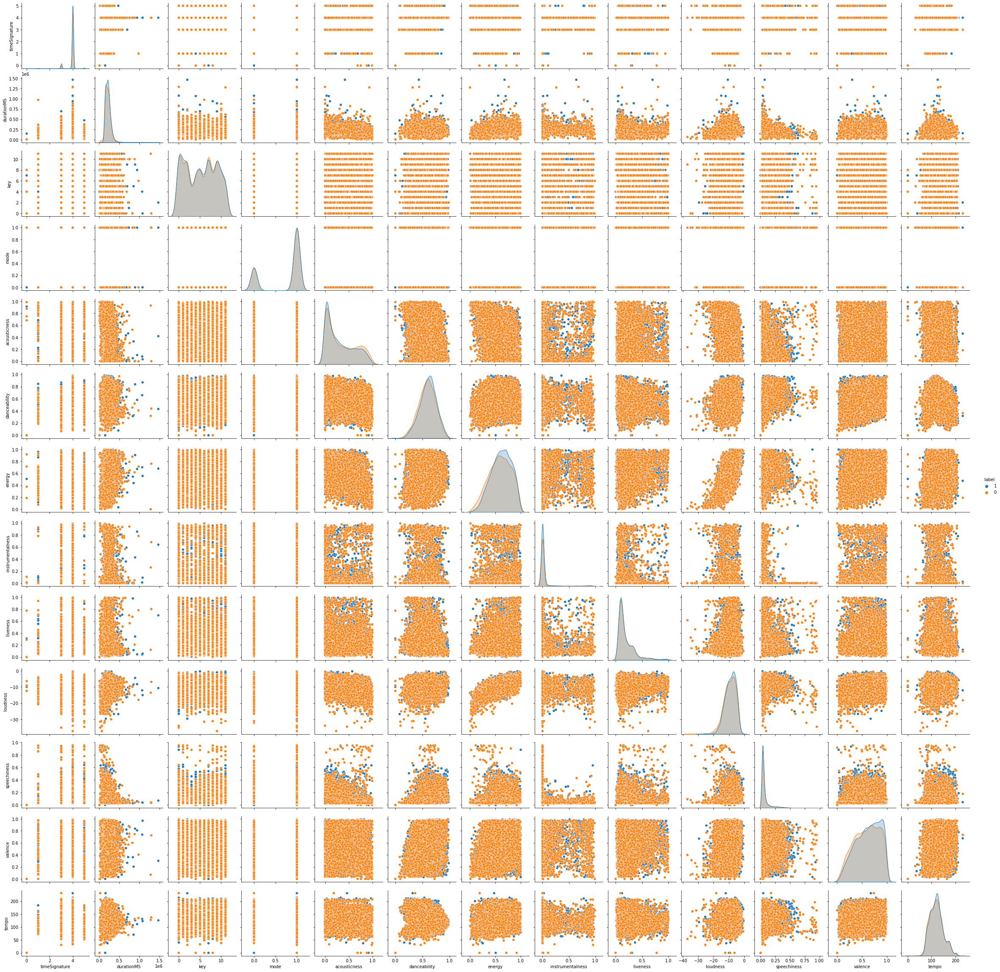

In [74]:
%matplotlib inline
import seaborn as sns
sns.pairplot(testData, hue='label')

There doesn't seem to be any distinguishable difference between hit and a not hit song among the audio features.

In [75]:
%matplotlib inline
import seaborn as sns
def printPairplot(df):
    sns.pairplot(df, hue='label')

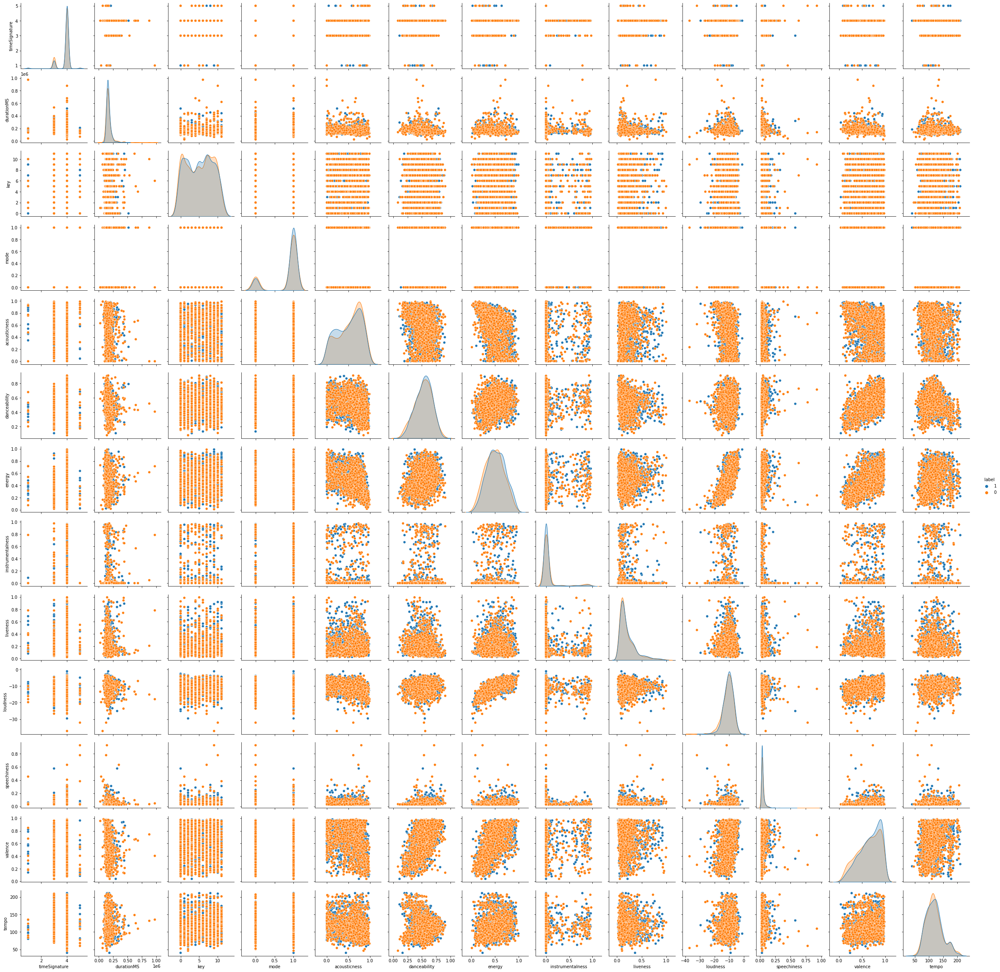

In [77]:
printPairplot(testData[testData['decade'] == '60'])

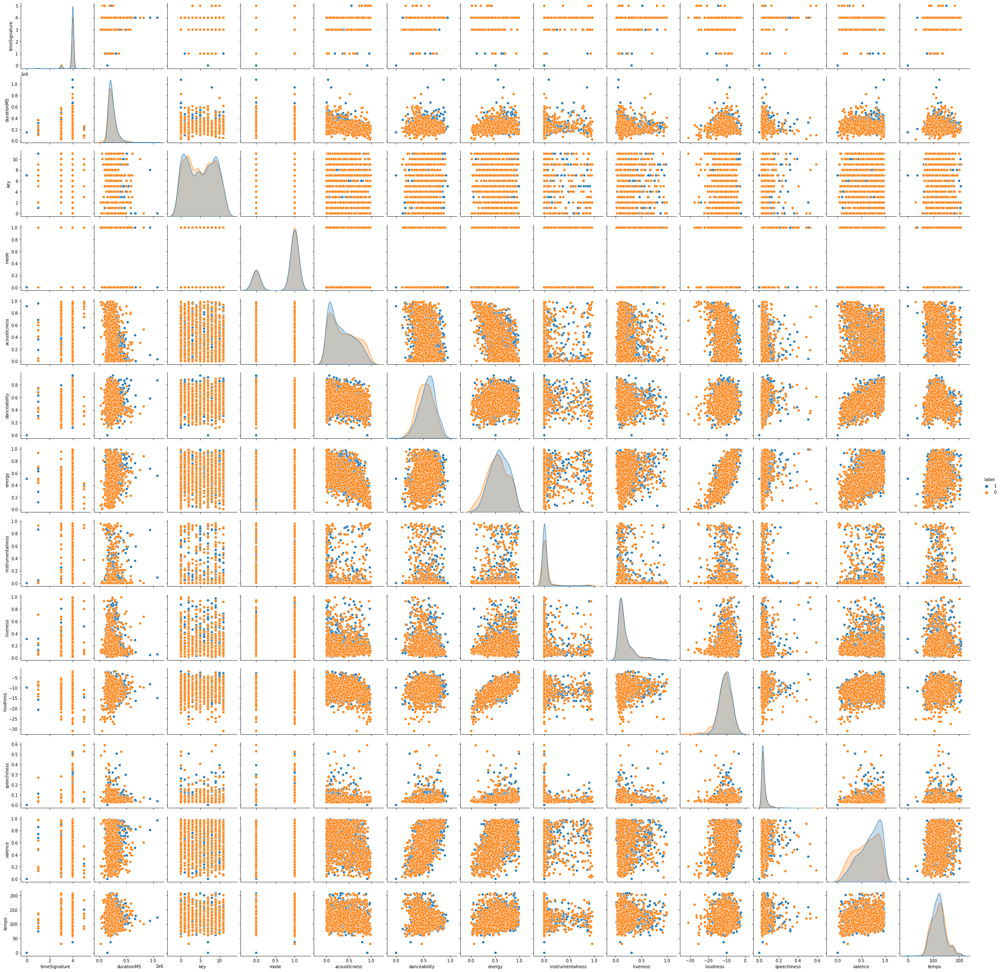

In [78]:
printPairplot(testData[testData['decade'] == '70'])

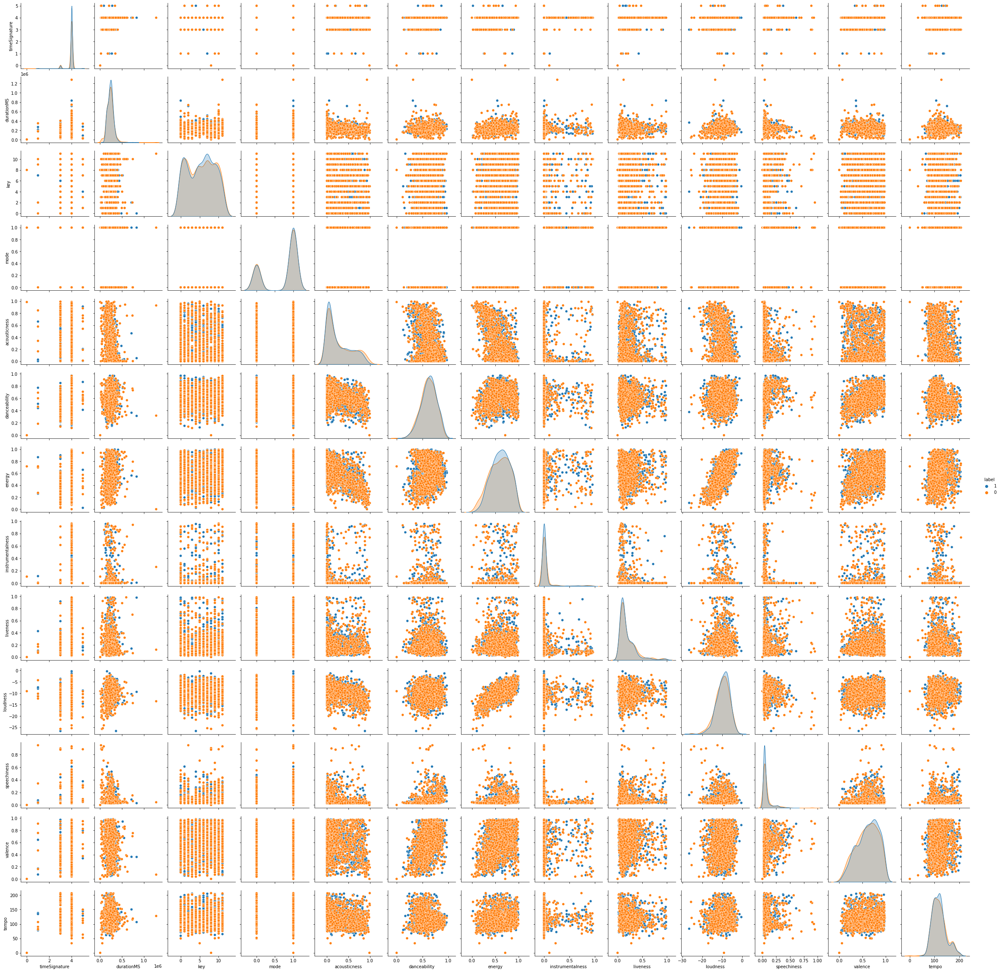

In [79]:
printPairplot(testData[testData['decade'] == '90'])

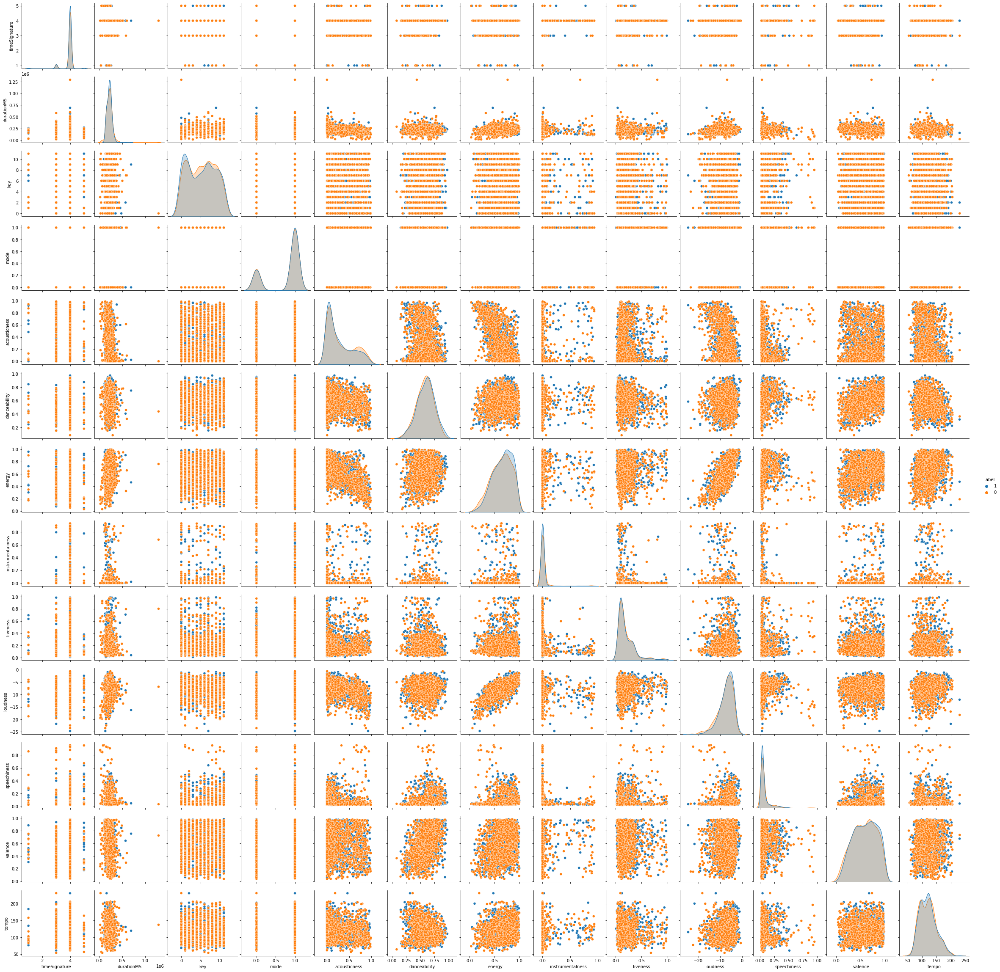

In [80]:
printPairplot(testData[testData['decade'] == '00'])

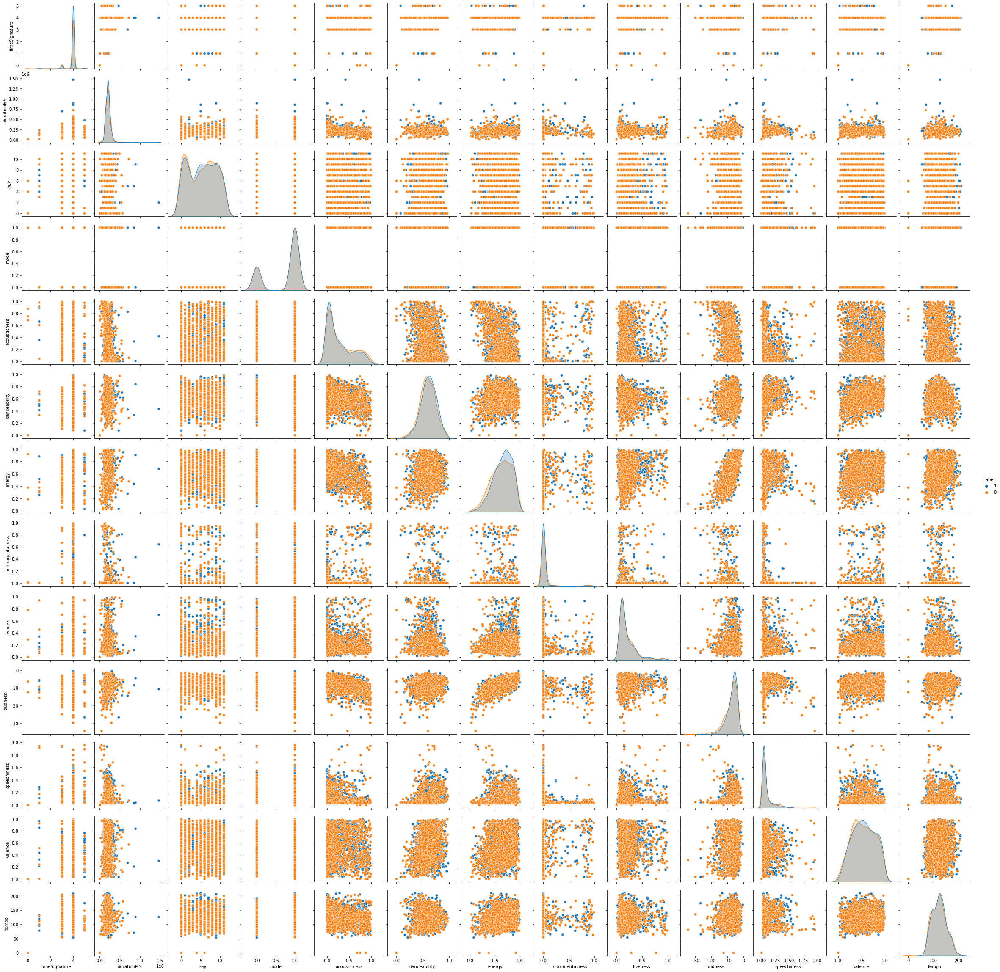

In [81]:
printPairplot(testData[testData['decade'] == '10'])

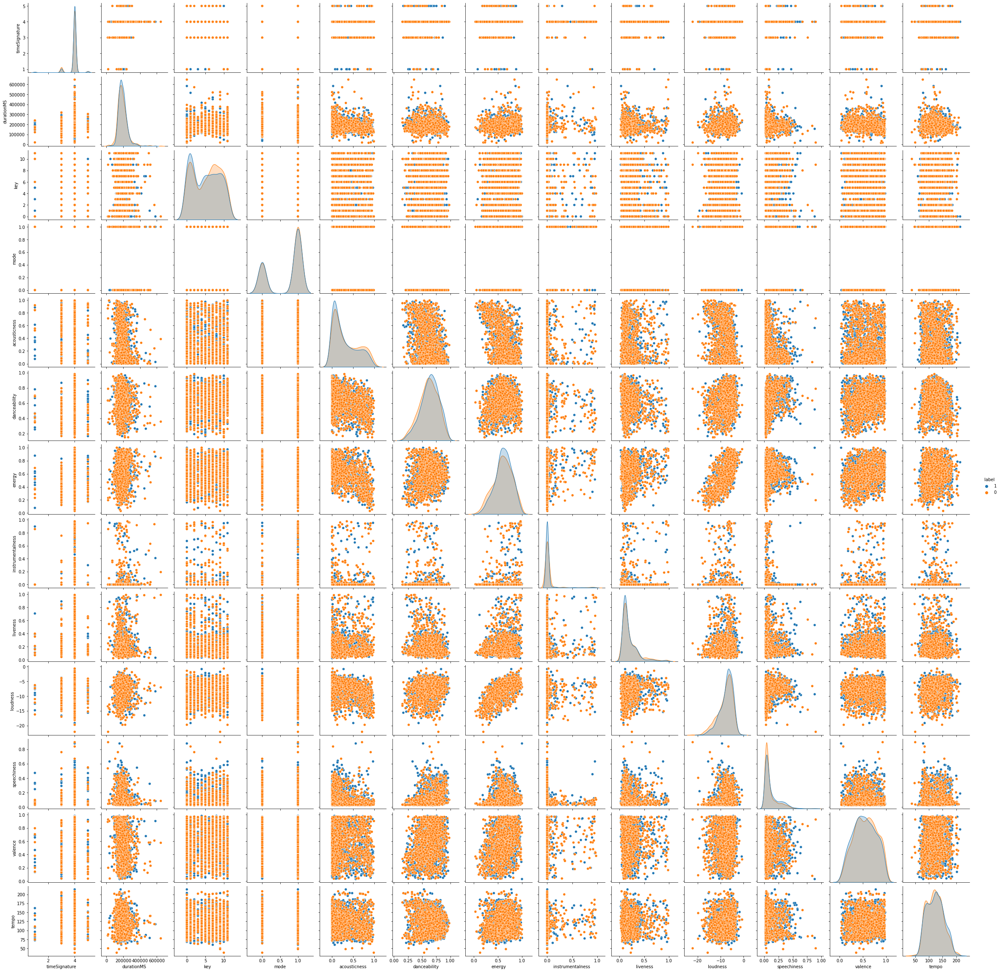

In [82]:
printPairplot(testData[testData['decade'] == '20'])

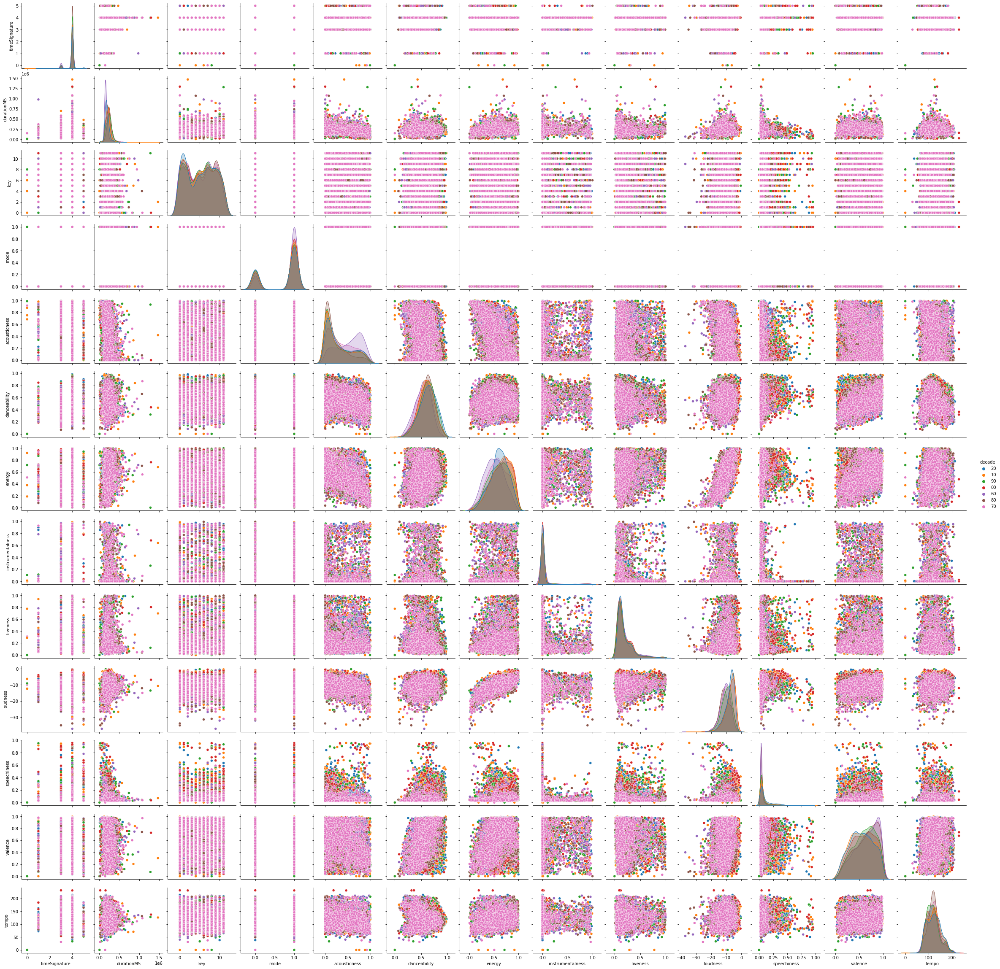

In [83]:
%matplotlib inline
import seaborn as sns
sns.pairplot(testData, hue='decade')

In [95]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder

# Now with scikit learn scaler let's scale everything between 0 and 1
scaler = ColumnTransformer([ 
    ("scale", MinMaxScaler(), ['durationMS', 'loudness', 'tempo', 'decade']),
    ("normalize", OneHotEncoder(), ['timeSignature', 'key', 'mode'])
    ], remainder='passthrough')
scaler.fit(testData.drop(['label'],axis=1))
scaled = scaler.transform(testData.drop(['label'],axis=1))

In [96]:
from sklearn.decomposition import TruncatedSVD

# Two-dimensional data
pca2 = TruncatedSVD(n_components=2)
pca2.fit(scaled)
pcaTwoData = pca2.transform(scaled)

# Two-dimensional data
pca3 = TruncatedSVD(n_components=3)
pca3.fit(scaled)
pcaThreeData = pca3.transform(scaled)

In [111]:
testData.label.array


<PandasArray>
['1', '1', '1', '1', '1', '1', '1', '1', '1', '1',
 ...
 '0', '0', '0', '0', '0', '0', '0', '0', '0', '0']
Length: 15498, dtype: object

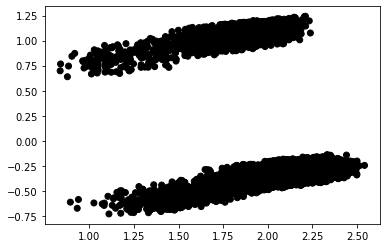

In [108]:
import matplotlib.pyplot as plt
%matplotlib inline
# Some plotting of the data
x, y = zip(*pcaTwoData)
plt.scatter(x, y, c=list(testData.label.array), cmap='blues')
plt.show()

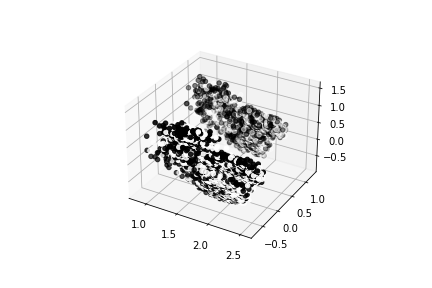

In [109]:
import matplotlib.pyplot as plt
%matplotlib widget
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

x, y, z = zip(*pcaThreeData)
ax.scatter(x, y, z, c=testData.label, cmap='blues')
plt.show()